# Riyadh Places Report 

# Table of Contents
1.[Installing the required libraries](#1.-Installing-the-required-libraries)
    
2.[loading the dataset](#2.-loading-the-dataset)

3.[ Basic statistics ](#3.-Basic-statistics)

4.[ Data Preparation ](#4.-Data-Preparation)

5.[ EDA ](#5.-EDA)

6.[Handle the Outliers](#6.-Handle-the-Outliers)

7.[ Normality Tests ](#7-normality-tests)

8.[Model Development](#8-model-development)

### 1- Installing the required libraries

In [34]:
# Importing libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from geopy.distance import geodesic
import folium
from folium.plugins import FastMarkerCluster
import scipy.stats as stats
from scipy.stats import shapiro, anderson, normaltest, ttest_ind

from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold
from sklearn.metrics import mean_squared_error, r2_score, accuracy_score, classification_report, make_scorer

import xgboost as xgb

### 2- loading the dataset

In [2]:
# Read data as a dataframe
riyadh_places = pd.read_csv('riyadh_places.csv')
riyadh_places.head()

,id,place_name,is_restaurant,categories,average_rating,rating_count,granular_category,latitude,longitude
0,1,Shawarma Alaz,RESTAURANT,Sandwich|Fast Food|Shawarma,3.0,3,restaurants,24.645118,46.717640
1,2,Eben Ezar,RESTAURANT,Asian|Japanese,3.2,5,restaurants,24.646631,46.717658
2,3,Chowking,RESTAURANT,Noodles,4.5,305,restaurants,24.646194,46.717444
3,4,100 islands delights,RESTAURANT,Asian|Seafood,4.4,239,restaurants,24.646334,46.717329
4,5,CUSINA Cafe,RESTAURANT,Coffee,4.7,19,restaurants,24.645628,46.717110


### 3- Basic statistics

In [3]:
riyadh_places.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11444 entries, 0 to 11443
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   id                 11444 non-null  int64  
 1   place_name         11444 non-null  object 
 2   is_restaurant      11444 non-null  object 
 3   categories         8822 non-null   object 
 4   average_rating     11444 non-null  float64
 5   rating_count       11444 non-null  int64  
 6   granular_category  11444 non-null  object 
 7   latitude           11444 non-null  float64
 8   longitude          11444 non-null  float64
dtypes: float64(3), int64(2), object(4)
memory usage: 804.8+ KB


In [4]:
riyadh_places.columns

Index(['id', 'place_name', 'is_restaurant', 'categories', 'average_rating',
       'rating_count', 'granular_category', 'latitude', 'longitude'],
      dtype='object')

In [5]:
riyadh_places.isna().sum()

id                      0
place_name              0
is_restaurant           0
categories           2622
average_rating          0
rating_count            0
granular_category       0
latitude                0
longitude               0
dtype: int64

In [6]:
riyadh_places.describe()

,id,average_rating,rating_count,latitude,longitude
count,11444.000000,11444.000000,11444.000000,11444.000000,11444.000000
mean,3964.082663,3.884979,201.219242,24.726261,46.703224
std,2419.258923,1.186164,595.588142,0.253107,0.185927
min,1.000000,0.000000,0.000000,24.126613,32.661729
25%,1991.000000,3.900000,8.000000,24.676572,46.658071
50%,3421.500000,4.200000,42.000000,24.740719,46.697127
75%,5975.250000,4.500000,173.000000,24.788898,46.762179
max,8836.000000,5.000000,19808.000000,49.079921,50.131243


In [7]:
riyadh_places.duplicated().sum()

0

## 4- Data Preparation

Adding new Feature :

In [8]:

def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # Convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    # Haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

# Locations of famous places in Riyadh
famous_places = {
    'Roshn_front': (24.841374, 46.733257),
    'Boulevard_World': (24.772508, 46.599586),
    'Boulevard_City': (24.768788, 46.604572),
    'Al_Bujairi_Heritage_Park': (24.736086, 46.574210),
    'Airport': (24.9637, 46.7008),
    'Winter_Garden': (24.802004, 46.580240)
}

# Add distance columns to the dataframe for each famous place
for place, coords in famous_places.items():
    riyadh_places[f'Distance_to_{place}'] = riyadh_places.apply(
        lambda row: haversine(coords[1], coords[0], row['longitude'], row['latitude']), axis=1
    )
riyadh_places.head()


,id,place_name,is_restaurant,categories,average_rating,rating_count,granular_category,latitude,longitude,Distance_to_Roshn_front,Distance_to_Boulevard_World,Distance_to_Boulevard_City,Distance_to_Al_Bujairi_Heritage_Park,Distance_to_Airport,Distance_to_Winter_Garden
0,1,Shawarma Alaz,RESTAURANT,Sandwich|Fast Food|Shawarma,3.0,3,restaurants,24.645118,46.717640,21.879573,18.516476,17.876172,17.671865,35.465448,22.291630
1,2,Eben Ezar,RESTAURANT,Asian|Japanese,3.2,5,restaurants,24.646631,46.717658,21.711674,18.389271,17.748249,17.577580,35.297526,22.161349
2,3,Chowking,RESTAURANT,Noodles,4.5,305,restaurants,24.646194,46.717444,21.761695,18.412263,17.771552,17.587297,35.345004,22.185711
3,4,100 islands delights,RESTAURANT,Asian|Seafood,4.4,239,restaurants,24.646334,46.717329,21.747061,18.392884,17.752167,17.568887,35.328937,22.166307
4,5,CUSINA Cafe,RESTAURANT,Coffee,4.7,19,restaurants,24.645628,46.717110,21.827001,18.438628,17.798356,17.595497,35.406331,22.213939


In [9]:


# Extended list of neighborhoods in Riyadh with their coordinates
riyadh_neighborhoods = [
    {"name": "Al Olaya", "latitude": 24.686952, "longitude": 46.685258},
    {"name": "Al Malaz", "latitude": 24.674825, "longitude": 46.730390},
    {"name": "Al Murabba", "latitude": 24.644389, "longitude": 46.709617},
    {"name": "As Sulaymaniyah", "latitude": 24.701947, "longitude": 46.682079},
    {"name": "Al Nakheel", "latitude": 24.713552, "longitude": 46.675297},
    {"name": "Al Mursalat", "latitude": 24.752778, "longitude": 46.703056},
    {"name": "King Fahd District", "latitude": 24.754850, "longitude": 46.660195},
    {"name": "Al Ghadeer", "latitude": 24.785104, "longitude": 46.654784},
    {"name": "Al Yasmin", "latitude": 24.808628, "longitude": 46.656942},
    {"name": "Al Rabwah", "latitude": 24.694165, "longitude": 46.754554},
    {"name": "Al Aqiq", "latitude": 24.751095, "longitude": 46.634494},
    {"name": "Al Malga", "latitude": 24.791148, "longitude": 46.653901},
    {"name": "Hittin", "latitude": 24.749649, "longitude": 46.624530},
    {"name": "Al Wurud", "latitude": 24.697718, "longitude": 46.657066},
    {"name": "Al Shifa", "latitude": 24.584106, "longitude": 46.616855},
    {"name": "Al Manar", "latitude": 24.712722, "longitude": 46.791878},
    {"name": "Al Hamra", "latitude": 24.760704, "longitude": 46.724462},
    {"name": "Al Khaleej", "latitude": 24.764883, "longitude": 46.773828},
    {"name": "Al Rawabi", "latitude": 24.692352, "longitude": 46.779854},
    {"name": "Al Thumamah", "latitude": 24.879735, "longitude": 46.786847},
    {"name": "Al Nuzhah", "latitude": 24.762800, "longitude": 46.688049},
    {"name": "Al Aziziyah", "latitude": 24.562802, "longitude": 46.704632},
    {"name": "Al Amal", "latitude": 24.652025, "longitude": 46.763330},
    {"name": "Al Falah", "latitude": 24.785632, "longitude": 46.717756},
    {"name": "Qurtubah", "latitude": 24.781034, "longitude": 46.726493},
    {"name": "An Nahdah", "latitude": 24.752058, "longitude": 46.788721},
    {"name": "Al Mughrizat", "latitude": 24.743685, "longitude": 46.715498},
    {"name": "Ash Shuhada", "latitude": 24.786214, "longitude": 46.763341},
    {"name": "Al Manakh", "latitude": 24.648611, "longitude": 46.772222},
    {"name": "Al Muruj", "latitude": 24.758034, "longitude": 46.682521}
]

# Function to find the nearest neighborhood
def find_neighborhood(latitude, longitude):
    min_distance = float('inf')
    neighborhood_name = None
    for neighborhood in riyadh_neighborhoods:
        distance = geodesic((latitude, longitude), (neighborhood["latitude"], neighborhood["longitude"])).kilometers
        if distance < min_distance:
            min_distance = distance
            neighborhood_name = neighborhood["name"]
    return neighborhood_name

# Add neighborhood column to the original dataset
riyadh_places['Neighborhood'] = riyadh_places.apply(lambda row: find_neighborhood(row['latitude'], row['longitude']), axis=1)

riyadh_places.head()

,id,place_name,is_restaurant,categories,average_rating,rating_count,granular_category,latitude,longitude,Distance_to_Roshn_front,Distance_to_Boulevard_World,Distance_to_Boulevard_City,Distance_to_Al_Bujairi_Heritage_Park,Distance_to_Airport,Distance_to_Winter_Garden,Neighborhood
0,1,Shawarma Alaz,RESTAURANT,Sandwich|Fast Food|Shawarma,3.0,3,restaurants,24.645118,46.717640,21.879573,18.516476,17.876172,17.671865,35.465448,22.291630,Al Murabba
1,2,Eben Ezar,RESTAURANT,Asian|Japanese,3.2,5,restaurants,24.646631,46.717658,21.711674,18.389271,17.748249,17.577580,35.297526,22.161349,Al Murabba
2,3,Chowking,RESTAURANT,Noodles,4.5,305,restaurants,24.646194,46.717444,21.761695,18.412263,17.771552,17.587297,35.345004,22.185711,Al Murabba
3,4,100 islands delights,RESTAURANT,Asian|Seafood,4.4,239,restaurants,24.646334,46.717329,21.747061,18.392884,17.752167,17.568887,35.328937,22.166307,Al Murabba
4,5,CUSINA Cafe,RESTAURANT,Coffee,4.7,19,restaurants,24.645628,46.717110,21.827001,18.438628,17.798356,17.595497,35.406331,22.213939,Al Murabba


## 5-EDA

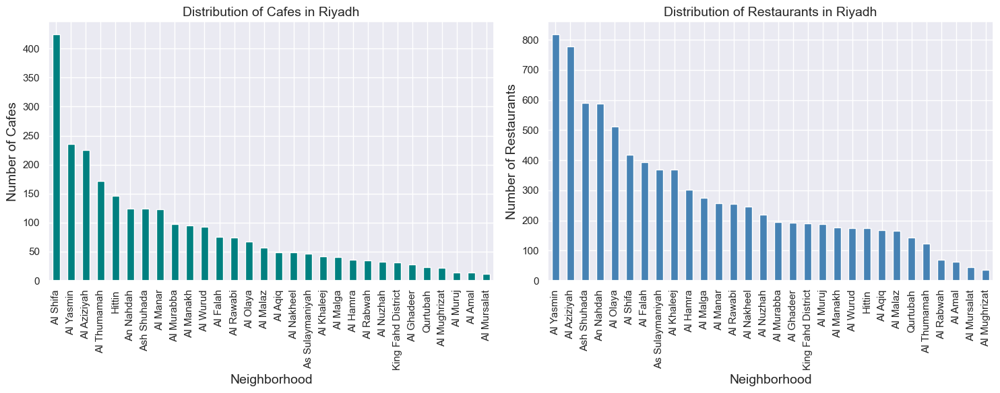

In [10]:

# Filter for cafes
cafes_only = riyadh_places[riyadh_places['granular_category'].str.lower() == 'caffe']

# Filter for restaurants
restaurants_only = riyadh_places[riyadh_places['granular_category'].str.lower() == 'restaurants']

# Count the number of cafes and restaurants in each neighborhood
neighborhood_cafe_counts = cafes_only['Neighborhood'].value_counts().sort_values(ascending=False)
neighborhood_restaurant_counts = restaurants_only['Neighborhood'].value_counts().sort_values(ascending=False)

# Setup the figure and axes for the subplots
sns.set_theme(palette="crest")  # Set the theme for nice colors
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))  # Create 1 row, 2 columns of plots

# Plot cafes
neighborhood_cafe_counts.plot(kind='bar', ax=axes[0], color='teal' )
axes[0].set_title('Distribution of Cafes in Riyadh', fontsize=14)
axes[0].set_ylabel('Number of Cafes', fontsize=14)
axes[0].set_xlabel('Neighborhood', fontsize=14)

# Plot restaurants
neighborhood_restaurant_counts.plot(kind='bar', ax=axes[1], color='steelblue')
axes[1].set_title('Distribution of Restaurants in Riyadh', fontsize=14)
axes[1].set_ylabel('Number of Restaurants', fontsize=14)
axes[1].set_xlabel('Neighborhood', fontsize=14)

plt.tight_layout()  # Adjust layout to not overlap
plt.show()  # Display the plots

/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/1111673538.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=categories, y=avg_ratings, palette="crest", ax=axes[0])
/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/1111673538.py:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=categories, y=rating_counts, palette="crest", ax=axes[1])


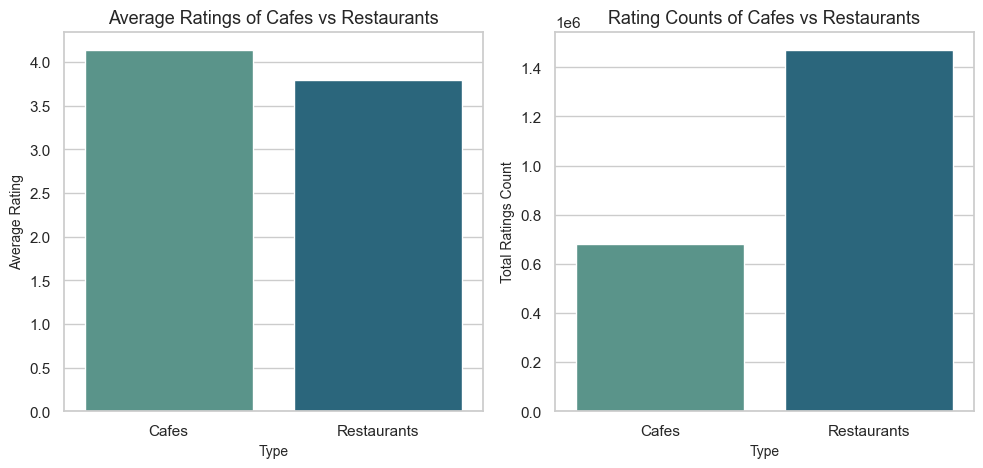

In [11]:

# Filter for cafes
cafes_only = riyadh_places[riyadh_places['granular_category'].str.lower() == 'caffe']

# Filter for restaurants
restaurants_only = riyadh_places[riyadh_places['granular_category'].str.lower() == 'restaurants']

# Calculate average of average ratings
average_rating_cafes = cafes_only['average_rating'].mean()
average_rating_restaurants = restaurants_only['average_rating'].mean()

# Calculate count of ratings
rating_count_cafes = cafes_only['rating_count'].sum()
rating_count_restaurants = restaurants_only['rating_count'].sum()

# Plotting
sns.set_theme(style="whitegrid")  # Setting the theme
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))  # Create 2 rows of plots

# Plot for Average Ratings
categories = ['Cafes', 'Restaurants']
avg_ratings = [average_rating_cafes, average_rating_restaurants]
sns.barplot(x=categories, y=avg_ratings, palette="crest", ax=axes[0])
axes[0].set_title('Average Ratings of Cafes vs Restaurants', fontsize=13)
axes[0].set_ylabel('Average Rating', fontsize=10)
axes[0].set_xlabel('Type', fontsize=10)

# Plot for Rating Counts
rating_counts = [rating_count_cafes, rating_count_restaurants]
sns.barplot(x=categories, y=rating_counts, palette="crest", ax=axes[1])
axes[1].set_title('Rating Counts of Cafes vs Restaurants', fontsize=13)
axes[1].set_ylabel('Total Ratings Count', fontsize=10)
axes[1].set_xlabel('Type', fontsize=10)

plt.tight_layout()  # Adjust layout to not overlap
plt.show()

/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/3241170781.py:10: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=cleaned_data[cleaned_data['granular_category'].str.lower() == 'restaurants'],
/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/3241170781.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=cleaned_data[cleaned_data['granular_category'].str.lower() == 'restaurants'],


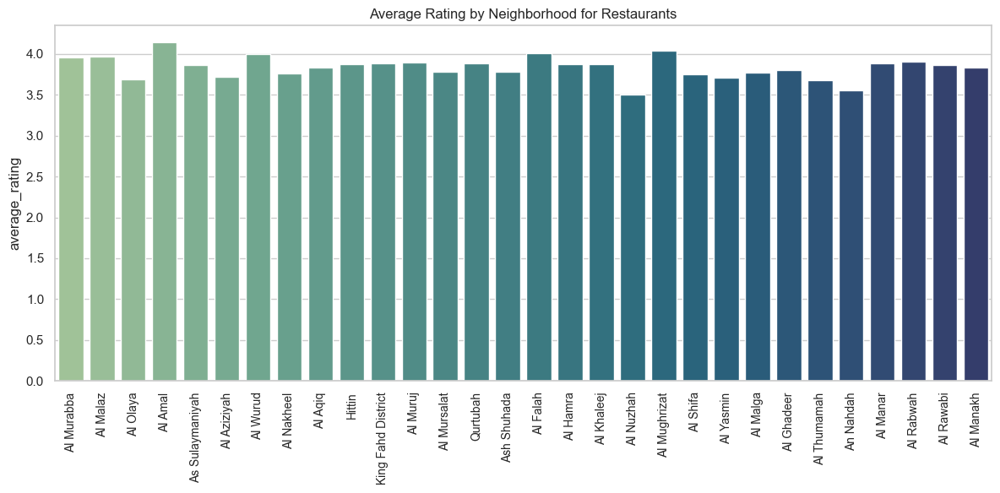

/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/3241170781.py:20: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=cleaned_data[cleaned_data['granular_category'].str.lower() == 'caffe'],
/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/3241170781.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=cleaned_data[cleaned_data['granular_category'].str.lower() == 'caffe'],


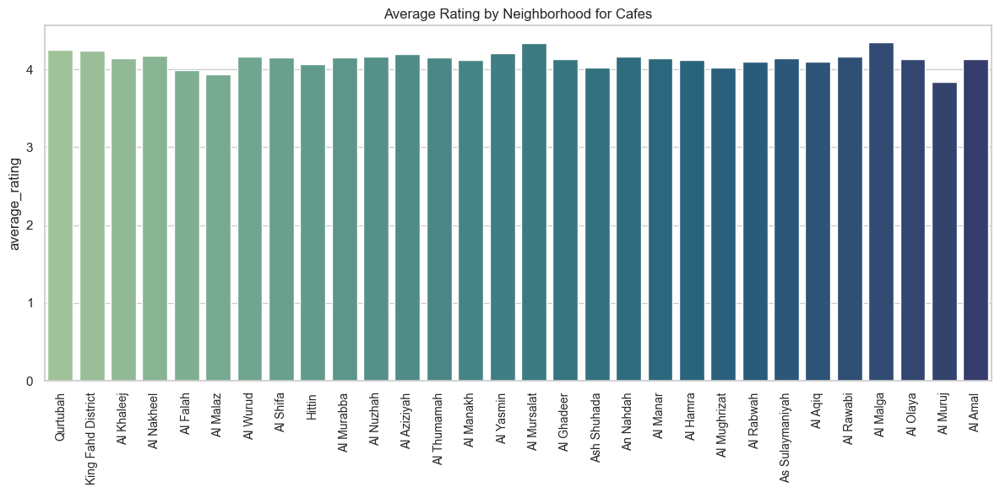

In [12]:
# Filter the original data to include only restaurants and cafes
restaurants_data = riyadh_places[riyadh_places['granular_category'].str.lower() == 'restaurants'].copy()
cafes_data = riyadh_places[riyadh_places['granular_category'].str.lower() == 'caffe'].copy()

# Combine the cleaned datasets for visualization
cleaned_data = pd.concat([restaurants_data, cafes_data])

# Plot for Restaurants
fig, ax = plt.subplots(figsize=(12, 6))
sns.barplot(data=cleaned_data[cleaned_data['granular_category'].str.lower() == 'restaurants'], 
            x='Neighborhood', y='average_rating', ci=None, palette='crest', ax=ax)
ax.set_title('Average Rating by Neighborhood for Restaurants')
ax.set_xlabel('')
ax.tick_params(axis='x', rotation=90, labelsize=10)
plt.tight_layout()
plt.show()

# Plot for Cafes
fig, ax = plt.subplots(figsize=(12, 6))
sns.barplot(data=cleaned_data[cleaned_data['granular_category'].str.lower() == 'caffe'], 
            x='Neighborhood', y='average_rating', ci=None, palette='crest', ax=ax)
ax.set_title('Average Rating by Neighborhood for Cafes')
ax.set_xlabel('')
ax.tick_params(axis='x', rotation=90, labelsize=10)
plt.tight_layout()
plt.show()


In [13]:
riyadh_places

,id,place_name,is_restaurant,categories,average_rating,rating_count,granular_category,latitude,longitude,Distance_to_Roshn_front,Distance_to_Boulevard_World,Distance_to_Boulevard_City,Distance_to_Al_Bujairi_Heritage_Park,Distance_to_Airport,Distance_to_Winter_Garden,Neighborhood
0,1,Shawarma Alaz,RESTAURANT,Sandwich|Fast Food|Shawarma,3.0,3,restaurants,24.645118,46.717640,21.879573,18.516476,17.876172,17.671865,35.465448,22.291630,Al Murabba
1,2,Eben Ezar,RESTAURANT,Asian|Japanese,3.2,5,restaurants,24.646631,46.717658,21.711674,18.389271,17.748249,17.577580,35.297526,22.161349,Al Murabba
2,3,Chowking,RESTAURANT,Noodles,4.5,305,restaurants,24.646194,46.717444,21.761695,18.412263,17.771552,17.587297,35.345004,22.185711,Al Murabba
3,4,100 islands delights,RESTAURANT,Asian|Seafood,4.4,239,restaurants,24.646334,46.717329,21.747061,18.392884,17.752167,17.568887,35.328937,22.166307,Al Murabba
4,5,CUSINA Cafe,RESTAURANT,Coffee,4.7,19,restaurants,24.645628,46.717110,21.827001,18.438628,17.798356,17.595497,35.406331,22.213939,Al Murabba
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11439,1125,PEAKS,Others,NaN,4.6,25,Caffe,24.742045,46.634809,14.857772,4.911605,4.262056,6.155667,25.530431,8.648987,Al Aqiq
11440,1124,Fc Lounge - اف سي لاونج,Others,NaN,3.5,539,Caffe,24.813115,46.768059,4.712610,17.595840,17.223883,21.363326,18.066473,18.997505,Ash Shuhada
11441,1123,ناريز,Others,NaN,3.8,39,Caffe,24.807277,46.852109,12.579585,25.783327,25.352711,29.152925,23.140471,27.447776,An Nahdah
11442,1122,فازا قهوة مختصة,Others,NaN,4.3,889,Caffe,24.772458,46.697337,8.477535,9.869190,9.374814,13.074296,21.268043,12.269069,Al Nuzhah


In [14]:


center = [riyadh_places['latitude'].mean(), riyadh_places['longitude'].mean()]

# Create a map centered around the average location
map_riyadh = folium.Map(location=center, zoom_start=10)

# Prepare data list for the markers
data_list = riyadh_places[['latitude', 'longitude', 'place_name', 'average_rating']].values.tolist()

# Define a callback function for customizing markers based on the average rating
callback = '''
function (row) {
    var iconUrl;
    if (row[3] >= 4) {
        iconUrl = 'location-green.png';  //add icon (grean marker for high ratings)
    } else if (row[3] >= 2.5) {
        iconUrl = 'location-orange.png';  //add icon (orange marker for medium ratings)
    } else {
        iconUrl = 'location-red.png';  //add icon (red marker for low ratings)
    }
    var icon = L.icon({
        iconUrl: iconUrl,
        iconSize: [30, 40],  // Size of the icon
        iconAnchor: [15, 34],  // Point of the icon which will correspond to marker's location
        popupAnchor:  [1, -34]  // Point from which the popup should open relative to the iconAnchor
    });
    var marker = L.marker(new L.LatLng(row[0], row[1]), {icon: icon});
    marker.bindPopup(row[2] + '<br/>Average Rating: ' + row[3].toFixed(1));
    return marker;
}
'''

# Use FastMarkerCluster to add markers to the map with the callback function
FastMarkerCluster(data=data_list, callback=callback).add_to(map_riyadh)

# Save and display the map
map_riyadh.save('map_riyadh.html')
map_riyadh

### 6- Handle the Outliers

In [15]:

# Filter for cafes
cafes = riyadh_places[riyadh_places['granular_category'].str.lower() == 'caffe']

# Filter for restaurants
restaurants = riyadh_places[riyadh_places['granular_category'].str.lower() == 'restaurants']

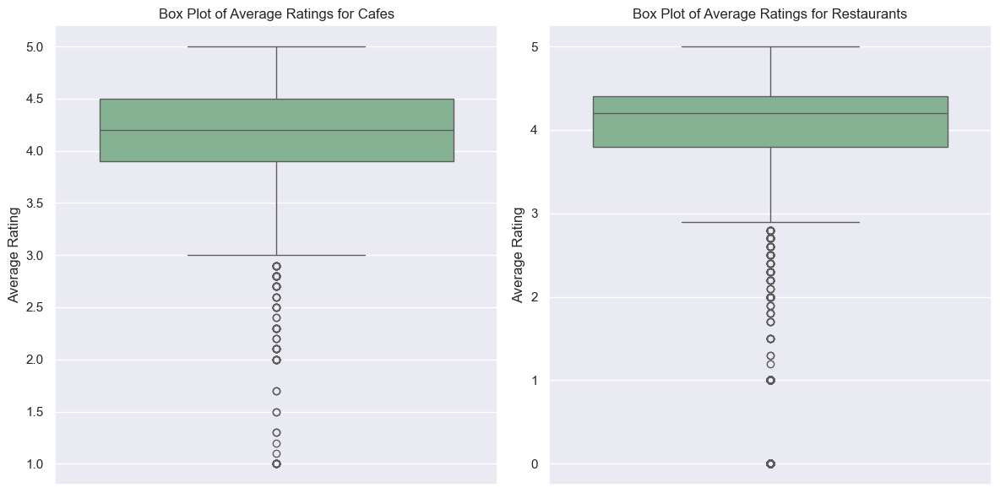

In [40]:
# Set up the matplotlib figure
plt.figure(figsize=(12, 6))

# Create a subplot for cafes
plt.subplot(1, 2, 1)  # 1 row, 2 columns, 1st subplot
sns.boxplot(y=cafes['average_rating'])
plt.title('Box Plot of Average Ratings for Cafes')
plt.ylabel('Average Rating')

# Create a subplot for restaurants
plt.subplot(1, 2, 2)  # 1 row, 2 columns, 2nd subplot
sns.boxplot(y=restaurants['average_rating'])
plt.title('Box Plot of Average Ratings for Restaurants')
plt.ylabel('Average Rating')
sns.set_theme(palette = 'crest')
plt.tight_layout()
plt.show()

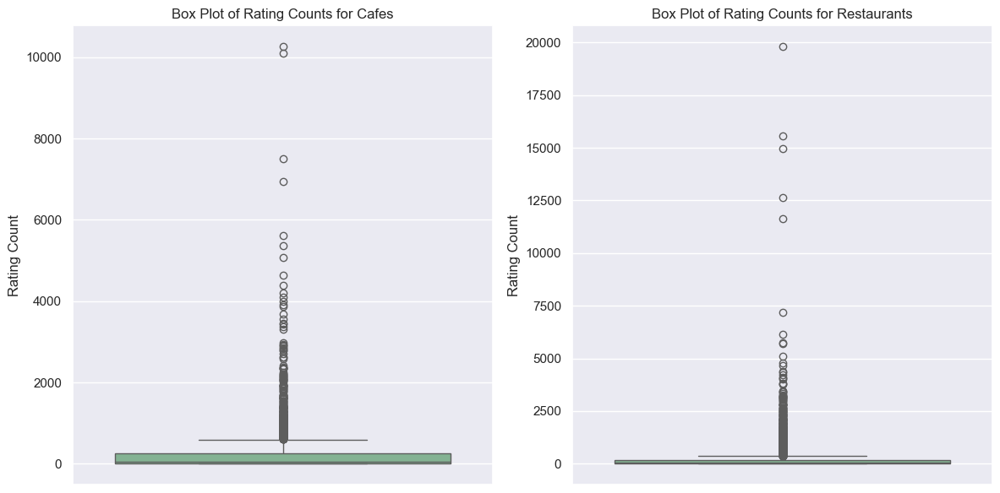

In [41]:
# Setting up the figure size for the plots
plt.figure(figsize=(12, 6))

# Creating the first subplot for the box plot of rating counts for cafes
plt.subplot(1, 2, 1)
sns.boxplot(y=cafes['rating_count'])
plt.title('Box Plot of Rating Counts for Cafes')
plt.ylabel('Rating Count')

# Creating the second subplot for the box plot of rating counts for restaurants
plt.subplot(1, 2, 2)
sns.boxplot(y=restaurants['rating_count'])
plt.title('Box Plot of Rating Counts for Restaurants')
plt.ylabel('Rating Count')
sns.set_theme(palette = 'crest')
# Adjusting the layout to prevent overlap and ensure plots are neatly arranged
plt.tight_layout()

# Displaying the plots
plt.show()

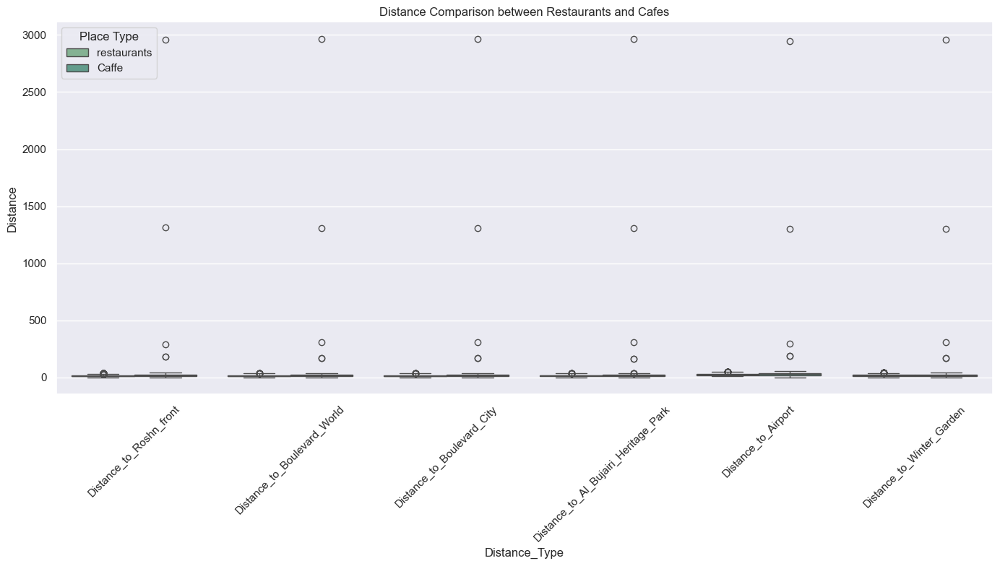

In [18]:

# Define the columns to plot
columns_to_plot = [
    'Distance_to_Roshn_front', 'Distance_to_Boulevard_World',
    'Distance_to_Boulevard_City', 'Distance_to_Al_Bujairi_Heritage_Park',
    'Distance_to_Airport', 'Distance_to_Winter_Garden'
] 
# Filter the dataframe to include only restaurants and cafes
filtered_data = riyadh_places[riyadh_places['granular_category'].isin(['restaurants', 'Caffe'])]

# Melt the dataframe for easier plotting with seaborn
melted_filtered_data = filtered_data.melt(id_vars=['granular_category'], value_vars=columns_to_plot, 
                                          var_name='Distance_Type', value_name='Distance')

# Create a box plot
plt.figure(figsize=(14, 8))
sns.boxplot(data=melted_filtered_data, x='Distance_Type', y='Distance', hue='granular_category')
plt.title('Distance Comparison between Restaurants and Cafes')
sns.set_theme(palette = 'crest')
plt.xticks(rotation=45)
plt.legend(title='Place Type')
plt.tight_layout()

# Show the plot
plt.show()

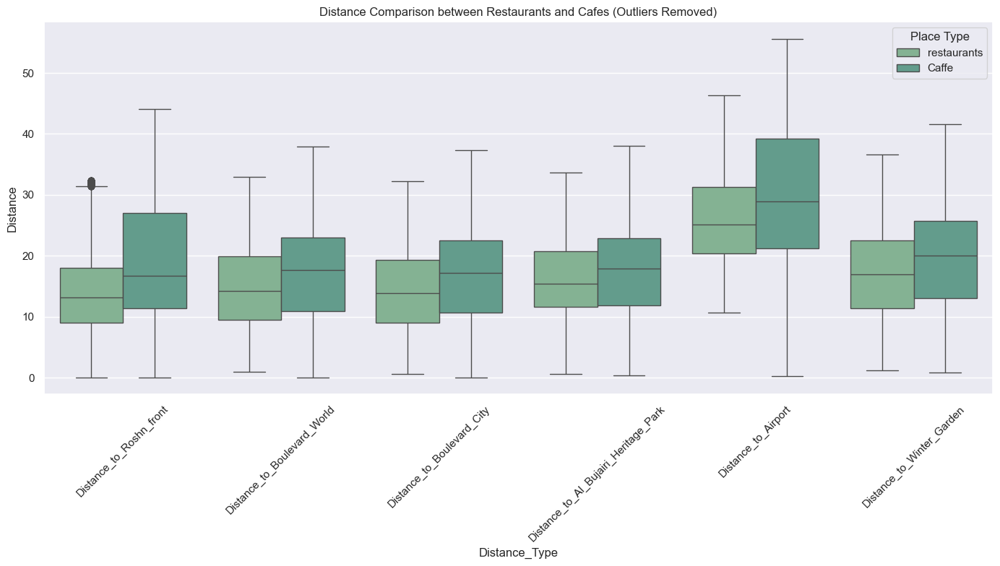

In [19]:
# Filter the original data to include only restaurants and cafes
restaurants_data = riyadh_places[riyadh_places['granular_category'] == 'restaurants'].copy()
cafes_data = riyadh_places[riyadh_places['granular_category'] == 'Caffe'].copy()

# Combine the cleaned datasets for visualization
cleaned_data = pd.concat([restaurants_data, cafes_data])

# Define the columns to plot
columns_to_plot = [
    'Distance_to_Roshn_front', 'Distance_to_Boulevard_World',
    'Distance_to_Boulevard_City', 'Distance_to_Al_Bujairi_Heritage_Park',
    'Distance_to_Airport', 'Distance_to_Winter_Garden'
]

# Define a function to remove outliers using the IQR method
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Apply the function to each distance column for restaurants
for column in columns_to_plot:
    restaurants_data = remove_outliers(restaurants_data, column)

# Apply the function to each distance column for cafes
for column in columns_to_plot:
    cafes_data = remove_outliers(cafes_data, column)



# Combine the cleaned datasets for visualization
cleaned_data = pd.concat([restaurants_data, cafes_data])

# Melt the dataframe for easier plotting with seaborn
melted_cleaned_data = cleaned_data.melt(id_vars=['granular_category'], value_vars=columns_to_plot, 
                                        var_name='Distance_Type', value_name='Distance')

# Create a box plot after removing outliers
plt.figure(figsize=(14, 8))
sns.boxplot(data=melted_cleaned_data, x='Distance_Type', y='Distance', hue='granular_category')
sns.set_theme(palette = 'crest')
plt.title('Distance Comparison between Restaurants and Cafes (Outliers Removed)')
plt.xticks(rotation=45)
plt.legend(title='Place Type')
plt.tight_layout()
plt.show()


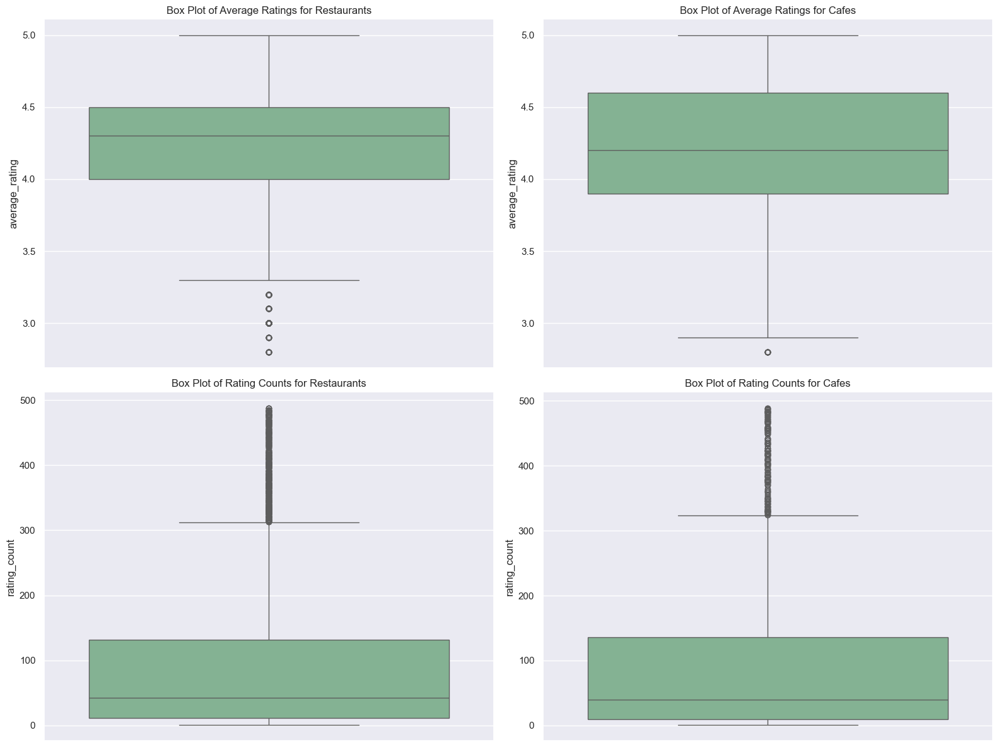

In [20]:
# Define the function to remove outliers using the IQR method
def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Columns to handle for outliers
rating_columns = ['average_rating', 'rating_count']

# Apply the function to each rating column for the combined cleaned data
for column in rating_columns:
    cleaned_data = remove_outliers(cleaned_data, column)


# Filter the data back into restaurants and cafes for visualization
restaurants_data_cleaned_ratings = cleaned_data[cleaned_data['granular_category'] == 'restaurants']
cafes_data_cleaned_ratings = cleaned_data[cleaned_data['granular_category'] == 'Caffe']

# Create box plots for ratings and rating counts
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Box plot for average ratings
sns.boxplot(ax=axes[0, 0], data=restaurants_data_cleaned_ratings, y='average_rating')
axes[0, 0].set_title('Box Plot of Average Ratings for Restaurants')

sns.boxplot(ax=axes[0, 1], data=cafes_data_cleaned_ratings, y='average_rating')
axes[0, 1].set_title('Box Plot of Average Ratings for Cafes')

# Box plot for rating counts
sns.boxplot(ax=axes[1, 0], data=restaurants_data_cleaned_ratings, y='rating_count')

axes[1, 0].set_title('Box Plot of Rating Counts for Restaurants')

sns.boxplot(ax=axes[1, 1], data=cafes_data_cleaned_ratings, y='rating_count')
axes[1, 1].set_title('Box Plot of Rating Counts for Cafes')

plt.tight_layout()
plt.show()

In [21]:
# Add 'Type' column to distinguish between restaurants and cafes
restaurants_data_cleaned_ratings['Type'] = 'Restaurant'
cafes_data_cleaned_ratings['Type'] = 'Cafe'

# Combine the datasets
cleaned_data = pd.concat([restaurants_data_cleaned_ratings, cafes_data_cleaned_ratings])
cleaned_data

/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/3788548133.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  restaurants_data_cleaned_ratings['Type'] = 'Restaurant'
/var/folders/4g/tyxt36t547j_n6f0ft31746r0000gn/T/ipykernel_3504/3788548133.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cafes_data_cleaned_ratings['Type'] = 'Cafe'


,id,place_name,is_restaurant,categories,average_rating,rating_count,granular_category,latitude,longitude,Distance_to_Roshn_front,Distance_to_Boulevard_World,Distance_to_Boulevard_City,Distance_to_Al_Bujairi_Heritage_Park,Distance_to_Airport,Distance_to_Winter_Garden,Neighborhood,Type
0,1,Shawarma Alaz,RESTAURANT,Sandwich|Fast Food|Shawarma,3.0,3,restaurants,24.645118,46.717640,21.879573,18.516476,17.876172,17.671865,35.465448,22.291630,Al Murabba,Restaurant
1,2,Eben Ezar,RESTAURANT,Asian|Japanese,3.2,5,restaurants,24.646631,46.717658,21.711674,18.389271,17.748249,17.577580,35.297526,22.161349,Al Murabba,Restaurant
2,3,Chowking,RESTAURANT,Noodles,4.5,305,restaurants,24.646194,46.717444,21.761695,18.412263,17.771552,17.587297,35.345004,22.185711,Al Murabba,Restaurant
3,4,100 islands delights,RESTAURANT,Asian|Seafood,4.4,239,restaurants,24.646334,46.717329,21.747061,18.392884,17.752167,17.568887,35.328937,22.166307,Al Murabba,Restaurant
4,5,CUSINA Cafe,RESTAURANT,Coffee,4.7,19,restaurants,24.645628,46.717110,21.827001,18.438628,17.798356,17.595497,35.406331,22.213939,Al Murabba,Restaurant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11435,1129,Starbucks,Others,NaN,3.0,3,Caffe,24.574811,46.677532,30.170192,23.351123,22.794288,20.751215,43.306209,27.107568,Al Aziziyah,Cafe
11436,1128,الشاهي العراقي,Others,NaN,4.4,12,Caffe,24.785884,46.570204,17.575493,3.318313,3.956365,5.552017,23.759369,2.058967,Hittin,Cafe
11438,1126,Joffrey's جوفريز,Others,NaN,2.9,34,Caffe,24.714688,46.634937,17.232791,7.354010,6.752209,6.578889,28.475373,11.170117,Al Wurud,Cafe
11439,1125,PEAKS,Others,NaN,4.6,25,Caffe,24.742045,46.634809,14.857772,4.911605,4.262056,6.155667,25.530431,8.648987,Al Aqiq,Cafe


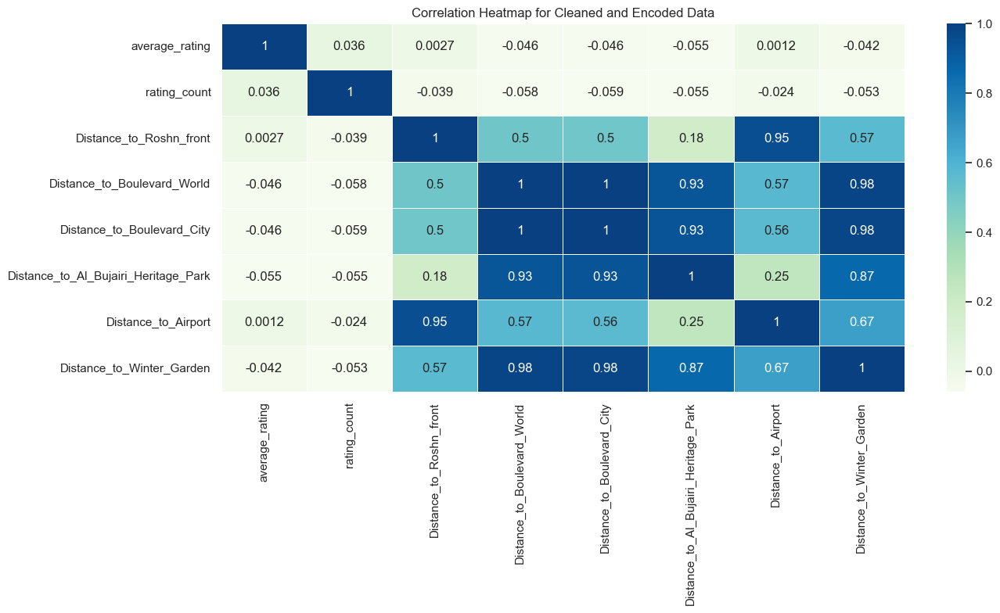

In [22]:
# Drop columns that are not useful for correlation analysis
cleaned_data = cleaned_data.drop(columns=['id', 'latitude', 'longitude'], errors='ignore')

# One-hot encode the 'Type' and 'Neighborhood' columns
encoded_data = pd.get_dummies(cleaned_data, columns=['Type', 'Neighborhood'])



# Select only numeric columns for the correlation matrix
numeric_cols = encoded_data.select_dtypes(include=[np.number])

# Calculate the correlation matrix for numeric columns only
corr_matrix = numeric_cols.corr()



# Create the heatmap for the correlation matrix
plt.figure(figsize=(14, 8))
sns.heatmap(corr_matrix, annot=True, cmap='GnBu', linewidths=0.5)
plt.title('Correlation Heatmap for Cleaned and Encoded Data')
plt.tight_layout()
plt.show()

### 7-Normality Tests

In [24]:

# Define a function to perform normality tests
def perform_normality_tests(data, columns):
    results = {}
    for column in columns:
        stat, p_value = shapiro(data[column])
        results[column] = {'Shapiro-Wilk Test': p_value}
        
        # Anderson-Darling Test
        result = anderson(data[column])
        results[column]['Anderson-Darling Test'] = result.statistic
        
        # D'Agostino and Pearson's Test
        stat, p_value = normaltest(data[column])
        results[column]['D\'Agostino-Pearson Test'] = p_value
        
    return pd.DataFrame(results).T

# List of columns to test
columns_to_test = numeric_cols

# Perform normality tests
normality_results = perform_normality_tests(cleaned_data, columns_to_test)
normality_results.head(10)

/Users/shodz/Library/Python/3.9/lib/python/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 8827.
  res = hypotest_fun_out(*samples, **kwds)


,Shapiro-Wilk Test,Anderson-Darling Test,D'Agostino-Pearson Test
average_rating,1.838495e-41,69.503475,6.614508e-84
rating_count,1.886258e-76,711.440248,0.000000e+00
Distance_to_Roshn_front,7.938652e-51,195.441688,4.240295e-142
Distance_to_Boulevard_World,7.062453e-31,39.752902,2.621607e-197
Distance_to_Boulevard_City,1.296496e-31,43.293888,2.258558e-207
Distance_to_Al_Bujairi_Heritage_Park,2.382769e-28,48.167128,4.040556e-81
Distance_to_Airport,1.176652e-45,142.120335,5.610527e-120
Distance_to_Winter_Garden,2.026874e-26,23.969682,3.138635e-129


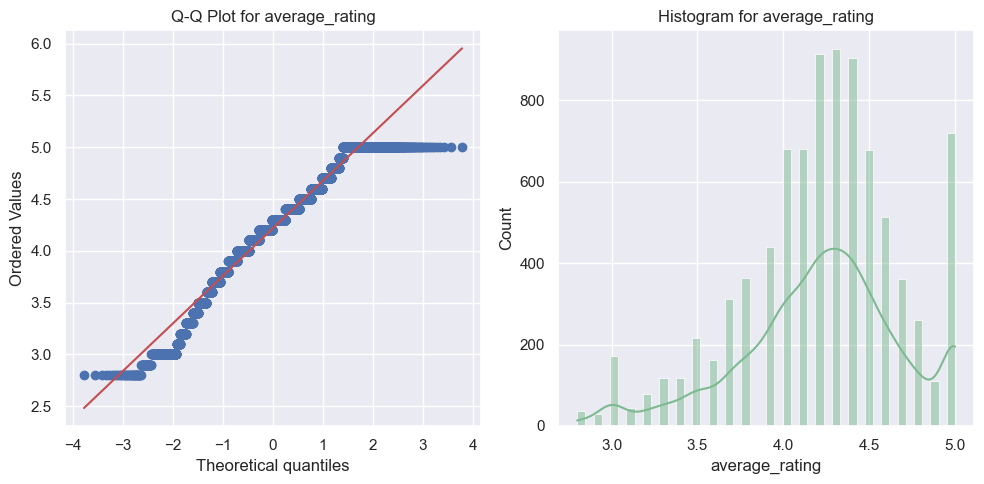

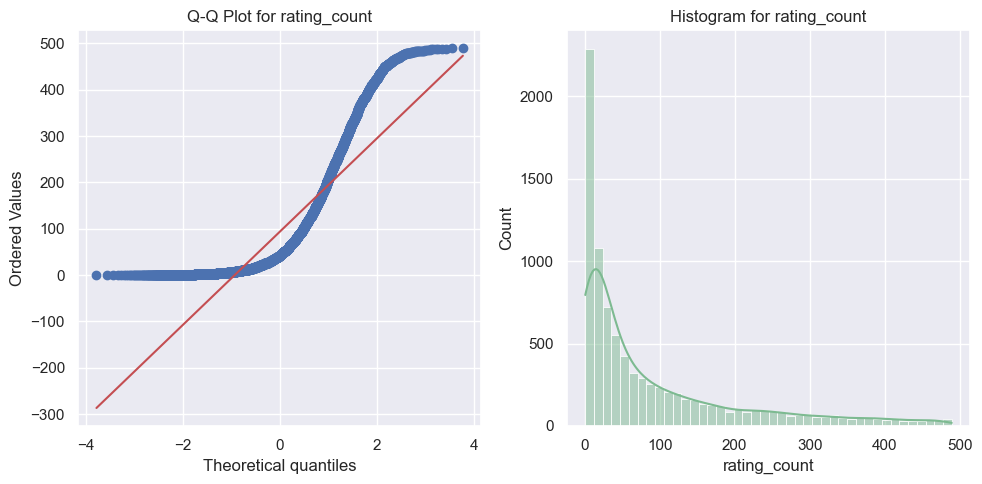

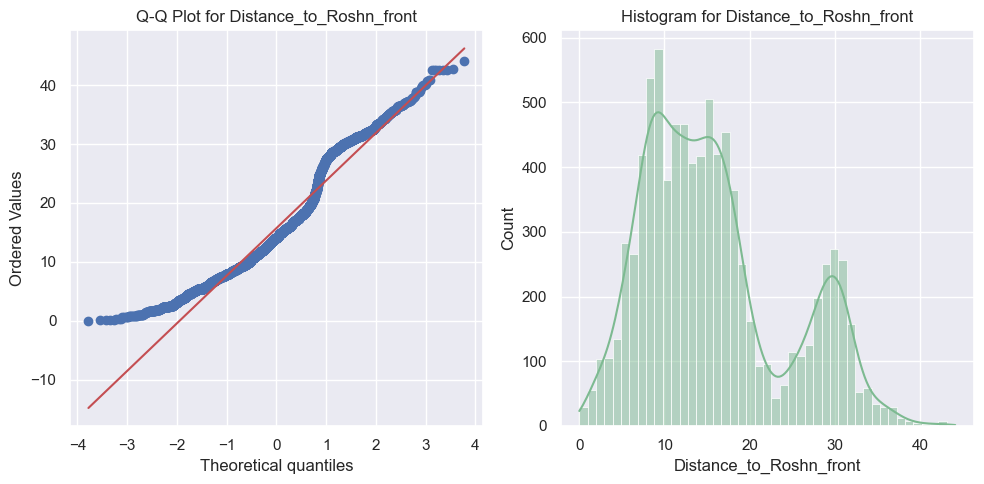

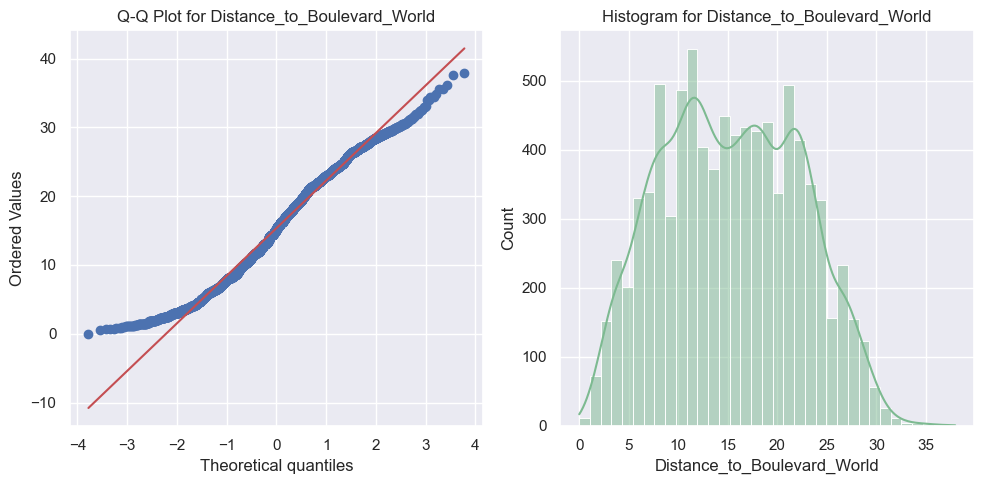

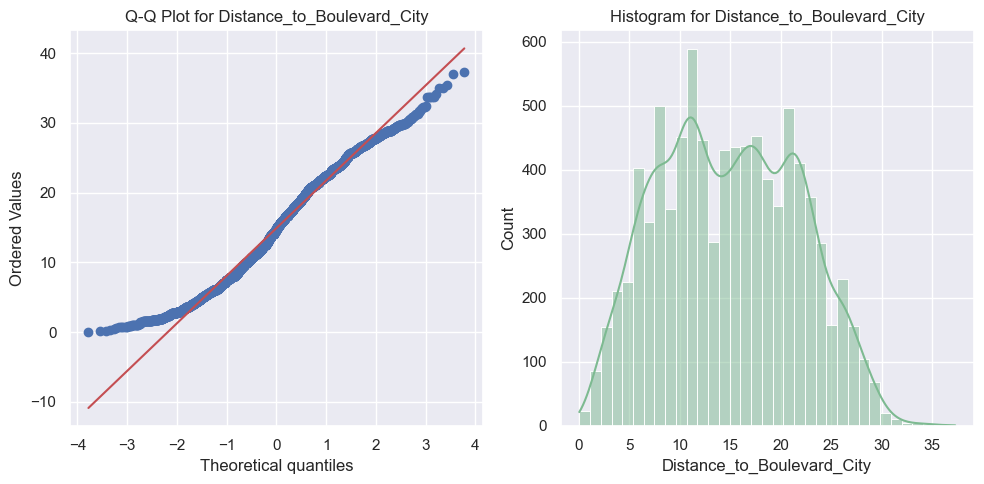

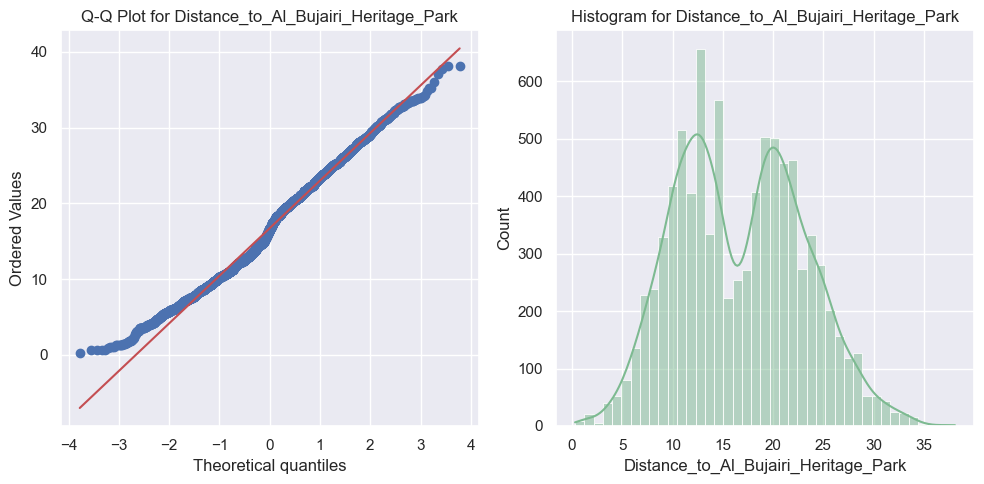

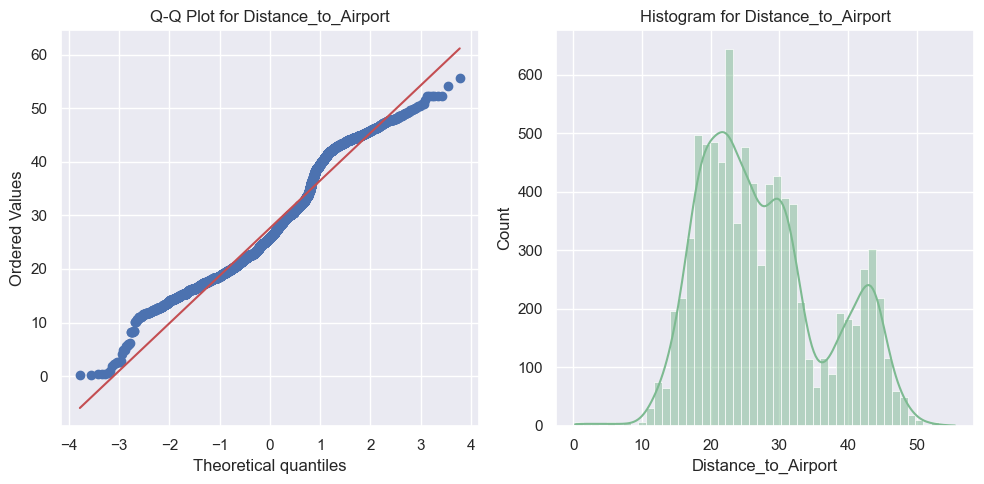

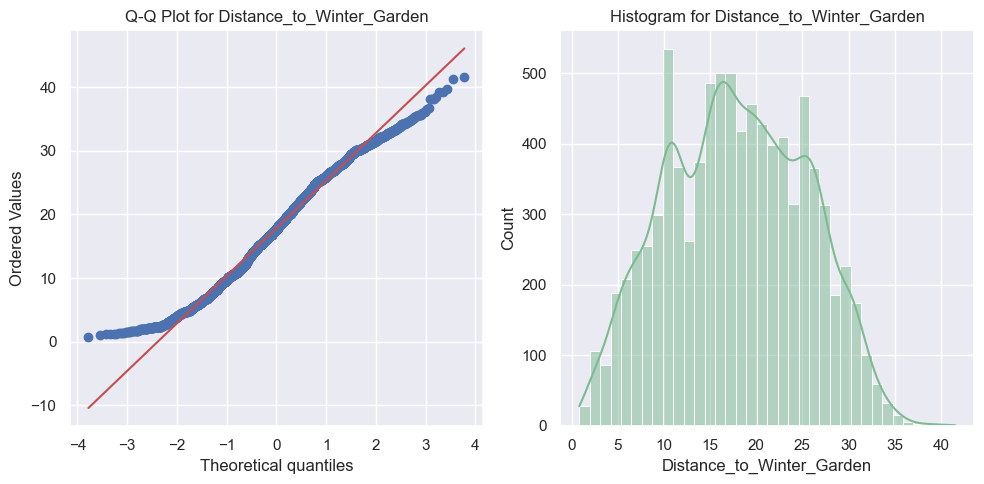

In [25]:
# Define a function to plot Q-Q plots and histograms
def plot_normality(data, columns):
    for column in columns:
        plt.figure(figsize=(10, 5))
        
        plt.subplot(1, 2, 1)
        stats.probplot(data[column], dist="norm", plot=plt)
        plt.title(f'Q-Q Plot for {column}')
        sns.set_theme(palette = 'crest')
        
        plt.subplot(1, 2, 2)
        sns.histplot(data[column], kde=True)
        plt.title(f'Histogram for {column}')
        sns.set_theme(palette = 'crest')
        plt.tight_layout()
        plt.show()

# Plot normality for the columns
plot_normality(cleaned_data, columns_to_test)

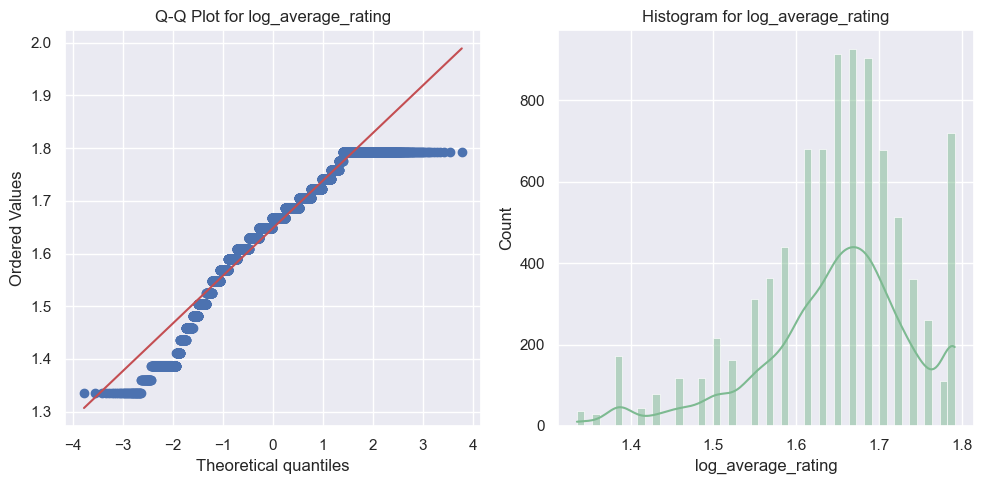

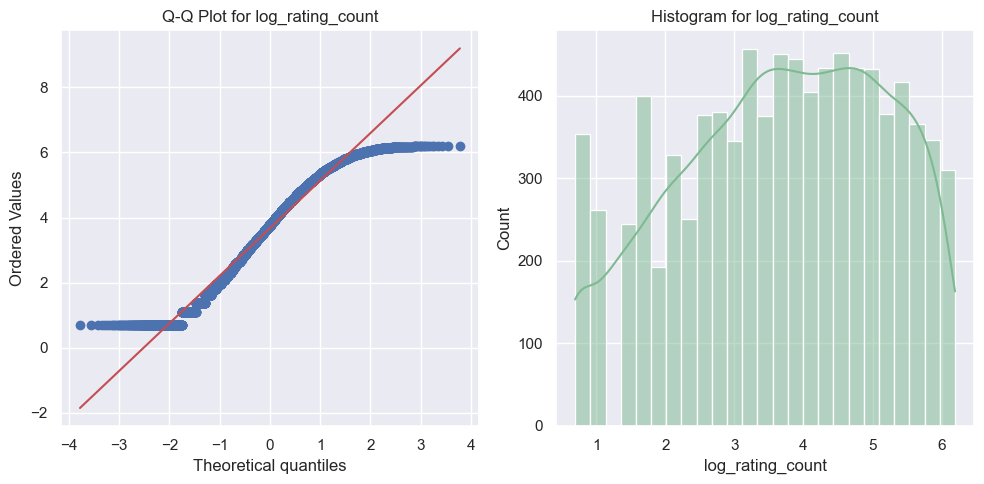

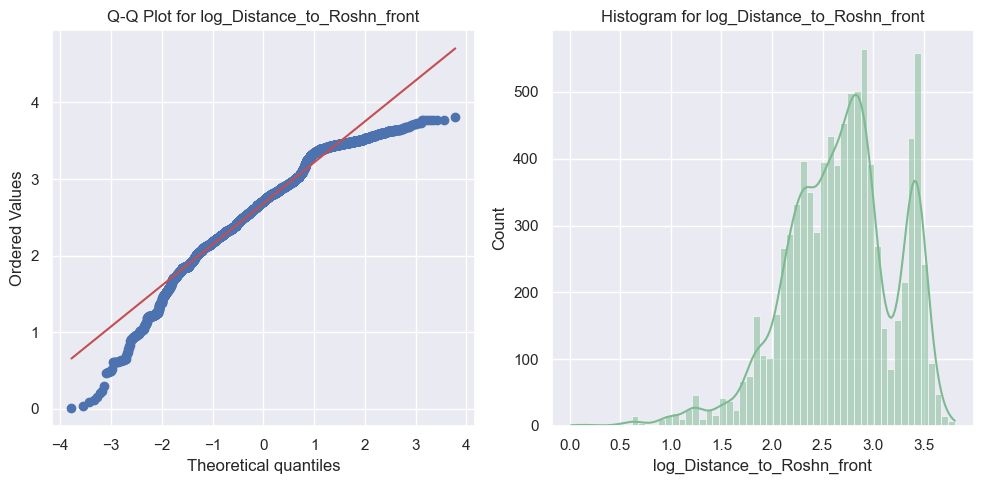

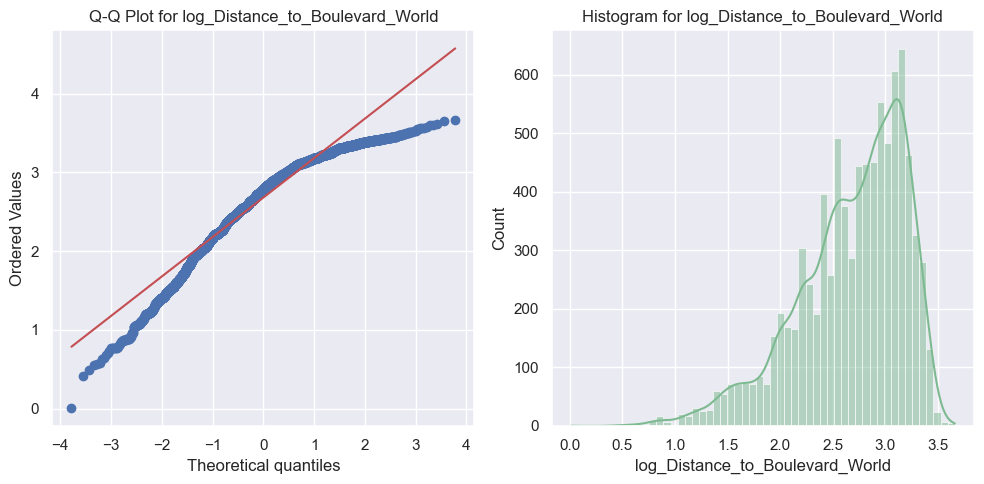

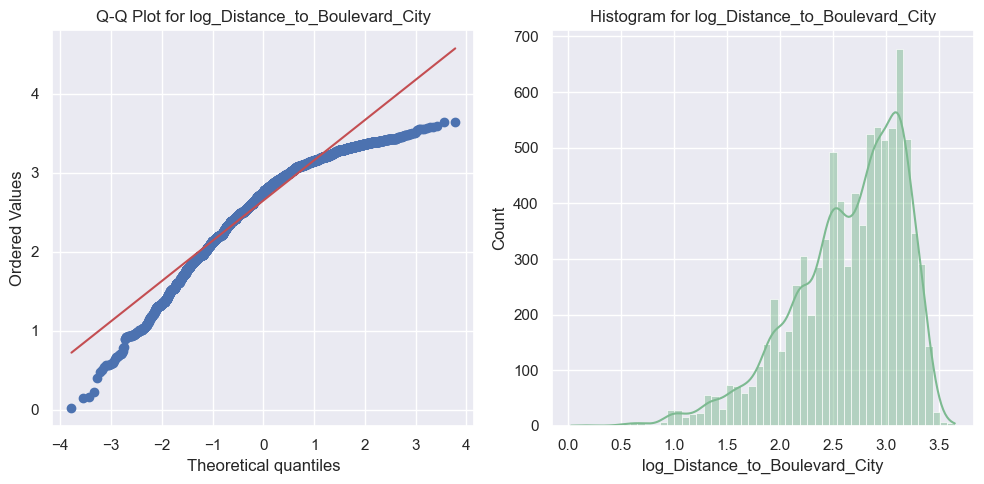

...

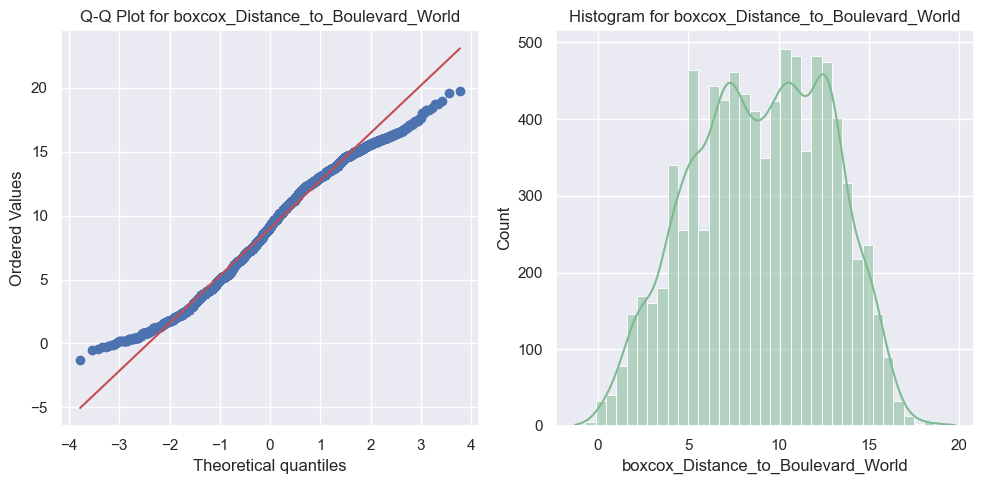

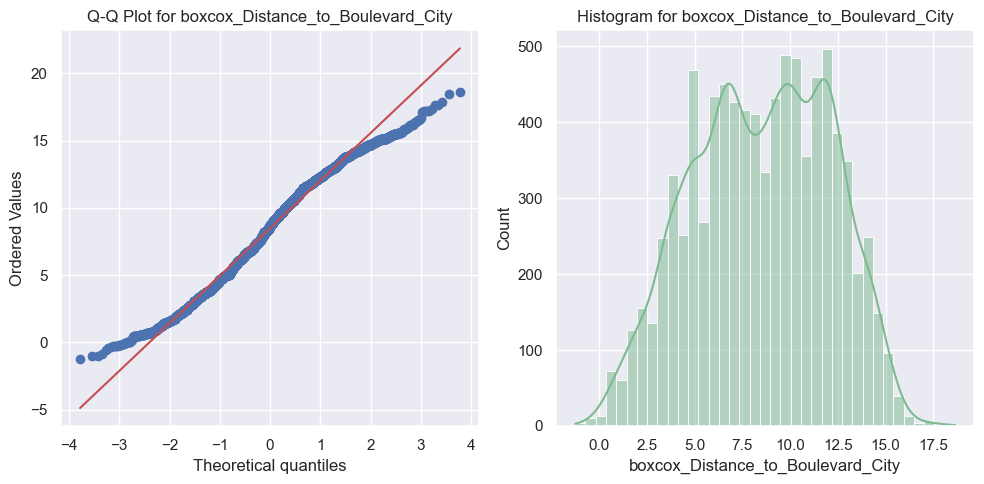

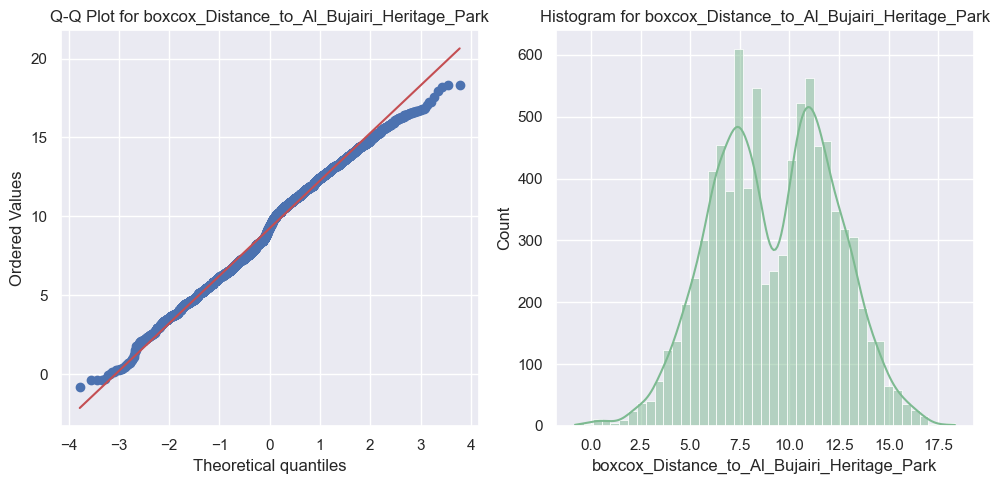

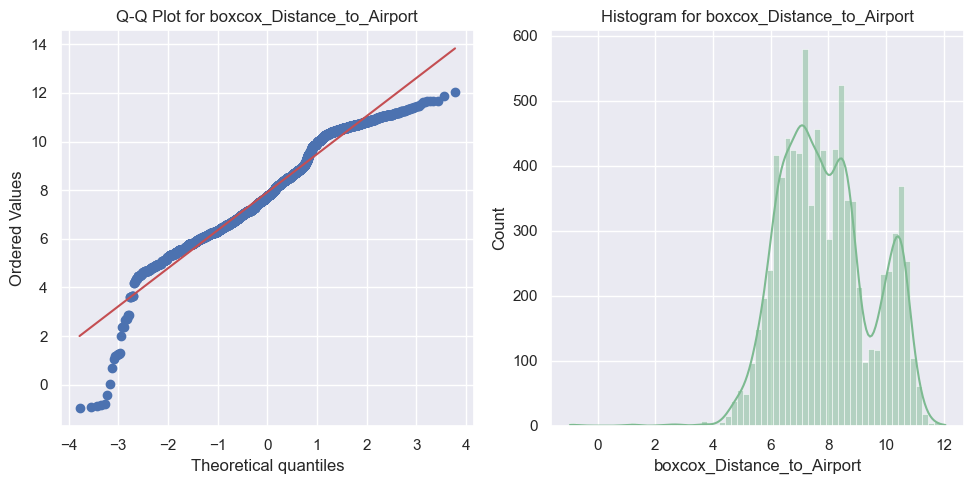

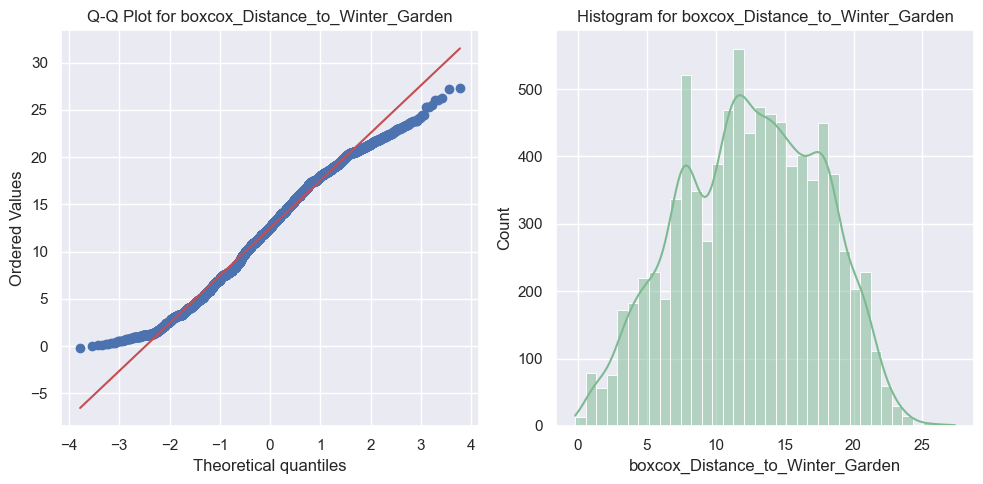

In [26]:
# Define a function to apply transformations
def transform_data(data, columns):
    for column in columns:
        # Log Transformation
        data[f'log_{column}'] = np.log1p(data[column])
        
        # Square Root Transformation
        data[f'sqrt_{column}'] = np.sqrt(data[column])
        
        # Box-Cox Transformation
        if np.all(data[column] > 0):  # Box-Cox requires positive values
            data[f'boxcox_{column}'], _ = stats.boxcox(data[column])
    
    return data

# Transform the data
transformed_data = transform_data(cleaned_data.copy(), columns_to_test)

# Plot normality for transformed columns
transformed_columns = [f'log_{col}' for col in columns_to_test] + \
                      [f'sqrt_{col}' for col in columns_to_test] + \
                      [f'boxcox_{col}' for col in columns_to_test]
plot_normality(transformed_data, transformed_columns)

In [45]:
from scipy.stats import shapiro, anderson, normaltest

def test_normality(data, columns):
    results = {}
    for column in columns:
        shapiro_p = shapiro(data[column])[1]
        anderson_stat = anderson(data[column]).statistic
        dagostino_p = normaltest(data[column])[1]
        results[column] = {
            'Shapiro-Wilk Test': shapiro_p,
            'Anderson-Darling Test': anderson_stat,
            'D\'Agostino-Pearson Test': dagostino_p
        }
    return results

normality_results = test_normality(transformed_data, transformed_columns)

# Print the results
normality_results_df = pd.DataFrame(normality_results).T
normality_results_df

/Users/shodz/Library/Python/3.9/lib/python/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 8827.



,Shapiro-Wilk Test,Anderson-Darling Test,D'Agostino-Pearson Test
log_average_rating,1.203752e-48,110.095666,6.379341e-195
log_rating_count,1.237214e-40,61.066243,6.260432e-293
log_Distance_to_Roshn_front,1.523387e-39,39.251328,2.365894e-120
log_Distance_to_Boulevard_World,2.250858e-51,142.725340,1.114156e-231
log_Distance_to_Boulevard_City,3.556275e-51,138.577974,8.235040e-236
log_Distance_to_Al_Bujairi_Heritage_Park,3.600229e-46,83.006094,1.081027e-251
log_Distance_to_Airport,3.531715e-48,32.407406,0.000000e+00
log_Distance_to_Winter_Garden,4.647593e-54,160.176213,1.623917e-302
sqrt_average_rating,7.098157e-46,92.528869,1.015842e-148
sqrt_rating_count,7.718183e-56,215.085896,6.928217e-169


In [28]:

# Create the pair plot with transformed data
sns.pairplot(transformed_data)
sns.set_theme(palette = 'crest')
plt.show()

### 8-MODEL DEVELOPMENT

In [29]:
transformed_data['high_rating'] = transformed_data['average_rating'] >= 4


In [32]:
# Select the relevant columns for the subset
columns_to_include = [
     'Distance_to_Roshn_front', 'Distance_to_Boulevard_World',
    'Distance_to_Boulevard_City', 'Distance_to_Al_Bujairi_Heritage_Park',
    'Distance_to_Airport', 'Distance_to_Winter_Garden',
     'sqrt_average_rating', 'sqrt_rating_count'
     , 'high_rating'
]

# Create the subset DataFrame
transformed_data_copy = transformed_data[columns_to_include]

# Define features and target variable for regression
regression_features = [col for col in transformed_data_copy.columns if col != 'sqrt_average_rating']
X = transformed_data_copy[regression_features]
y = transformed_data_copy['sqrt_average_rating']

# Split the data into training + validation set and test set
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Further split the training + validation set into training set and validation set
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Define the model
reg_model = LinearRegression()

# Define the cross-validation method
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Train the model using cross-validation on the training set
cross_val_scores = cross_val_score(reg_model, X_train, y_train, cv=kf, scoring='neg_mean_squared_error')
print(f'Cross-Validated MSE on training set: {-cross_val_scores.mean()}')

# Train the model on the full training set
reg_model.fit(X_train, y_train)

# Validate the model on the validation set
y_val_pred = reg_model.predict(X_val)
print(f'Validation MSE: {mean_squared_error(y_val, y_val_pred)}')
print(f'Validation R2 Score: {r2_score(y_val, y_val_pred)}')

# After tuning and validating the model, evaluate it on the test set
y_test_pred = reg_model.predict(X_test)
print(f'Test MSE: {mean_squared_error(y_test, y_test_pred)}')
print(f'Test R2 Score: {r2_score(y_test, y_test_pred)}')

Cross-Validated MSE on training set: 0.005254948749328676
Validation MSE: 0.005332037499876316
Validation R2 Score: 0.6114101489132031
Test MSE: 0.0052976325982757545
Test R2 Score: 0.6191595676191366


In [35]:
# Select the relevant columns for the subset
columns_to_include = [
     'Distance_to_Roshn_front', 'Distance_to_Boulevard_World',
    'Distance_to_Boulevard_City', 'Distance_to_Al_Bujairi_Heritage_Park',
    'Distance_to_Airport', 'Distance_to_Winter_Garden',
     'sqrt_average_rating', 'sqrt_rating_count'
     , 'high_rating'
]

# Create the subset DataFrame
transformed_data_copy = transformed_data[columns_to_include]

# Define features and target variable for regression
regression_features = [col for col in transformed_data_copy.columns if col != 'sqrt_average_rating']
X = transformed_data_copy[regression_features]
y = transformed_data_copy['sqrt_average_rating']

# Split the data into training + validation set and test set
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Further split the training + validation set into training set and validation set
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Define the model
rf_model = RandomForestRegressor(random_state=42)

# Define the hyperparameters grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Set up the grid search
grid_search = GridSearchCV(estimator=rf_model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error', n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_rf_model = grid_search.best_estimator_

# Validate the best model on the validation set
y_val_pred = best_rf_model.predict(X_val)
print(f'Validation MSE: {mean_squared_error(y_val, y_val_pred)}')
print(f'Validation R2 Score: {r2_score(y_val, y_val_pred)}')

# Evaluate the best model on the test set
y_test_pred = best_rf_model.predict(X_test)
print(f'Test MSE: {mean_squared_error(y_test, y_test_pred)}')
print(f'Test R2 Score: {r2_score(y_test, y_test_pred)}')

Validation MSE: 0.004325979426948045
Validation R2 Score: 0.6847299552260686
Test MSE: 0.0042018155701199645
Test R2 Score: 0.6979365350798463


In [ ]:
# Select the relevant columns for the subset
columns_to_include = [
     'Distance_to_Roshn_front', 'Distance_to_Boulevard_World',
    'Distance_to_Boulevard_City', 'Distance_to_Al_Bujairi_Heritage_Park',
    'Distance_to_Airport', 'Distance_to_Winter_Garden',
     'sqrt_average_rating', 'sqrt_rating_count'
     , 'high_rating'
]

# Create the subset DataFrame
transformed_data_copy = transformed_data[columns_to_include]

# Define features and target variable for regression
regression_features = [col for col in transformed_data_copy.columns if col != 'sqrt_average_rating']
X = transformed_data_copy[regression_features]
y = transformed_data_copy['sqrt_average_rating']

# Split the data into training + validation set and test set
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Further split the training + validation set into training set and validation set
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Define the model
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Define the hyperparameters grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 6, 9],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# Set up the grid search
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_xgb_model = grid_search.best_estimator_

# Validate the best model on the validation set
y_val_pred = best_xgb_model.predict(X_val)
print(f'Validation MSE: {mean_squared_error(y_val, y_val_pred)}')
print(f'Validation R2 Score: {r2_score(y_val, y_val_pred)}')

# Evaluate the best model on the test set
y_test_pred = best_xgb_model.predict(X_test)
print(f'Test MSE: {mean_squared_error(y_test, y_test_pred)}')
print(f'Test R2 Score: {r2_score(y_test, y_test_pred)}')

Fitting 3 folds for each of 243 candidates, totalling 729 fits
Validation MSE: 0.004086978209667143
Validation R2 Score: 0.6973608998914538
Test MSE: 0.004078442976996422
Test R2 Score: 0.6669856180857451


In [ ]:
# Select the relevant columns for the subset using Square Root Transformation
columns_to_include = [
    'Distance_to_Roshn_front',
    'Distance_to_Airport',
    'sqrt_average_rating', 'sqrt_rating_count', 'high_rating'
]

# Create the subset DataFrame
transformed_data_copy = transformed_data[columns_to_include]

# Define features and target variable for regression
regression_features = [col for col in transformed_data_copy.columns if col != 'sqrt_average_rating']
X = transformed_data_copy[regression_features]
y = transformed_data_copy['sqrt_average_rating']

# Split the data into training + validation set and test set
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Further split the training + validation set into training set and validation set
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2

# Define the model
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42)

# Define the hyperparameters grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 6, 9],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0]
}

# Set up the grid search
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_xgb_model = grid_search.best_estimator_

# Validate the best model on the validation set
y_val_pred = best_xgb_model.predict(X_val)
print(f'Validation MSE: {mean_squared_error(y_val, y_val_pred)}')
print(f'Validation R2 Score: {r2_score(y_val, y_val_pred)}')

# Evaluate the best model on the test set
y_test_pred = best_xgb_model.predict(X_test)
print(f'Test MSE: {mean_squared_error(y_test, y_test_pred)}')
print(f'Test R2 Score: {r2_score(y_test, y_test_pred)}')

Fitting 3 folds for each of 243 candidates, totalling 729 fits
Validation MSE: 0.004080076300546334
Validation R2 Score: 0.697871983498509
Test MSE: 0.004059668491477379
Test R2 Score: 0.6685185986192835


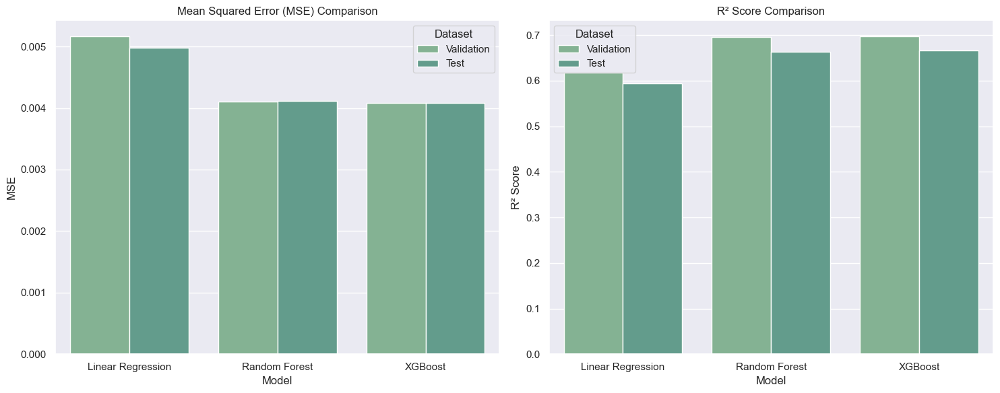

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Define the performance metrics for each model
models = ['Linear Regression', 'Random Forest', 'XGBoost']
validation_mse = [0.005165555190426371, 0.00410804909664356, 0.004086978209667143]
validation_r2 = [0.6174927062997511, 0.6958006091470724, 0.6973608998914538]
test_mse = [0.004975049587484819, 0.004117837689264217, 0.004078442976996422]
test_r2 = [0.5937755970320928, 0.6637689479421278, 0.6669856180857451]

# Create a DataFrame for easier plotting
data = {
    'Model': models * 2,
    'MSE': validation_mse + test_mse,
    'R²': validation_r2 + test_r2,
    'Dataset': ['Validation'] * 3 + ['Test'] * 3
}
df = pd.DataFrame(data)

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Plot MSE
sns.barplot(x='Model', y='MSE', hue='Dataset', data=df, ax=axes[0])
axes[0].set_title('Mean Squared Error (MSE) Comparison')
axes[0].set_ylabel('MSE')
axes[0].set_xlabel('Model')


# Plot R²
sns.barplot(x='Model', y='R²', hue='Dataset', data=df, ax=axes[1])
axes[1].set_title('R² Score Comparison')
axes[1].set_ylabel('R² Score')
axes[1].set_xlabel('Model')
# Adjust layout
plt.tight_layout()
plt.show()